# Experiment `20200321a`

In [8]:
import numpy as np
import pyUn0 as pyUn0
import os, plotly
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

313602 156801.0 156800
Data acquired


<IPython.core.display.Javascript object>


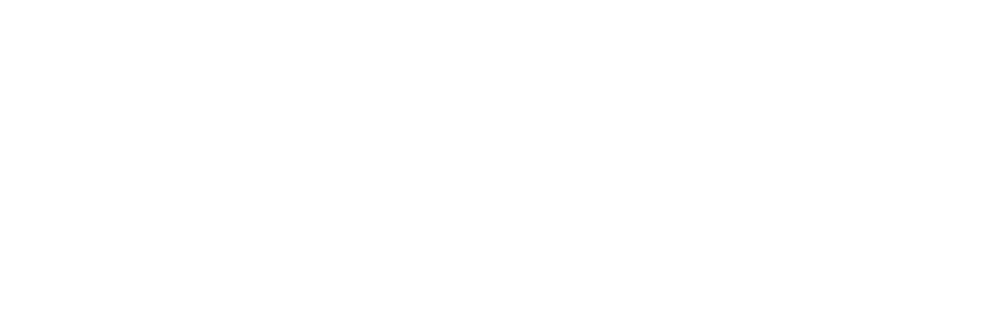

PyExiv not present


<IPython.core.display.Javascript object>


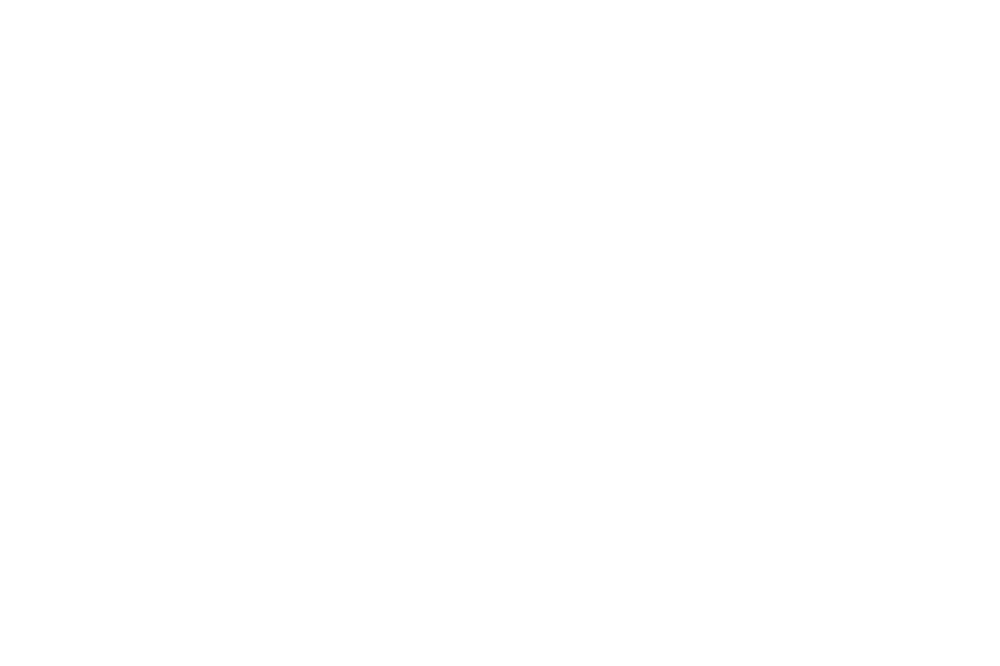

15680 10
PyExiv not present
Experiment: 20200321a-1
Duration: 245.0us (250000 - 5000), for 10 repeats each 2500.0us
Fech = 64.0Msps, total of 15680.0 pts per line, Nacq = 10
50ns at shooting time, probe: BiVi Piezo, target = Film box with water
Timestamp = 2020-03-21 19:29:31.823838
313602 156801.0 156800
Data acquired


<IPython.core.display.Javascript object>


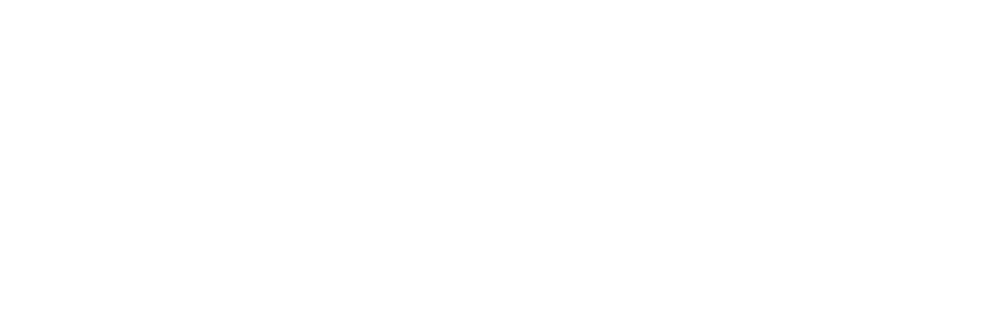

PyExiv not present


<IPython.core.display.Javascript object>


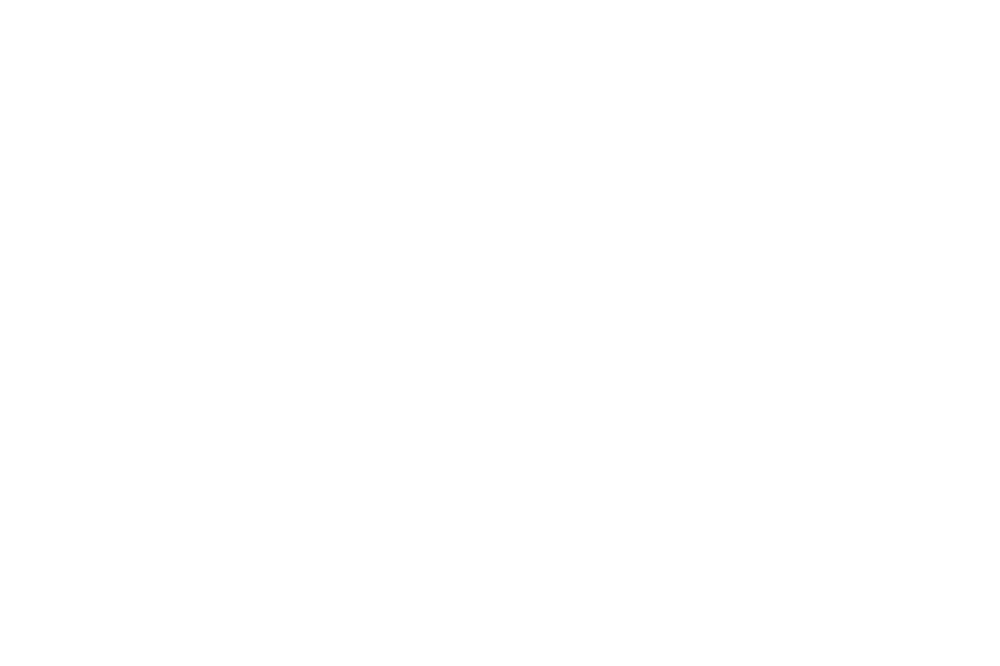

15680 10
PyExiv not present
Experiment: 20200321a-3
Duration: 245.0us (250000 - 5000), for 10 repeats each 2500.0us
Fech = 64.0Msps, total of 15680.0 pts per line, Nacq = 10
100ns at shooting time, probe: BiVi Piezo, target = Film box with water
Timestamp = 2020-03-21 19:32:20.726649
313602 156801.0 156800
Data acquired


<IPython.core.display.Javascript object>


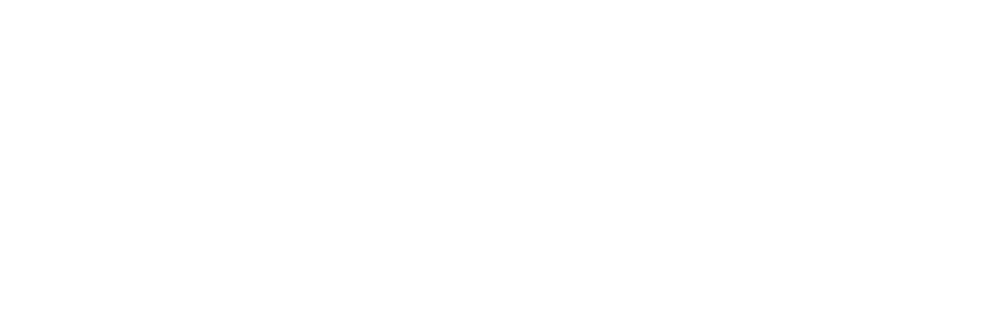

PyExiv not present


<IPython.core.display.Javascript object>


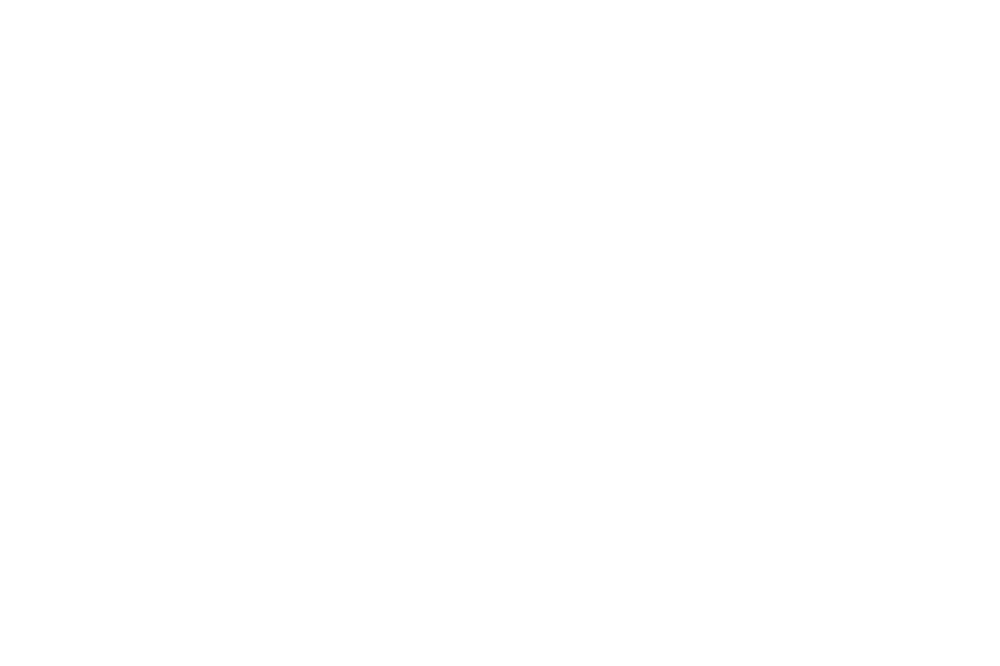

15680 10
PyExiv not present
Experiment: 20200321a-2
Duration: 245.0us (250000 - 5000), for 10 repeats each 2500.0us
Fech = 64.0Msps, total of 15680.0 pts per line, Nacq = 10
150ns at shooting time, probe: BiVi Piezo, target = Film box with water
Timestamp = 2020-03-21 19:30:49.828992
313602 156801.0 156800
Data acquired


<IPython.core.display.Javascript object>


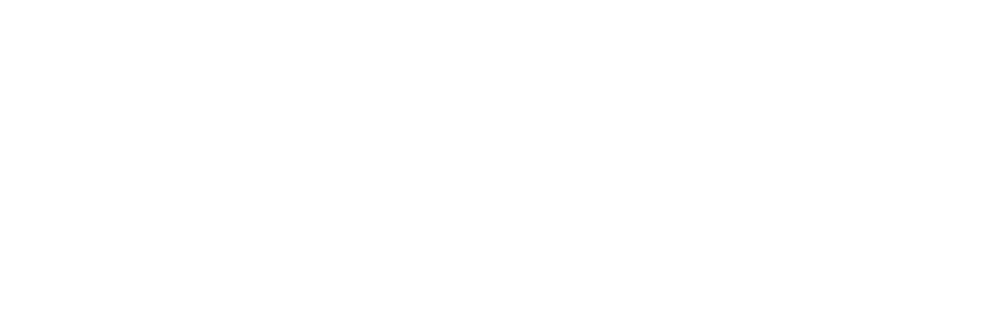

PyExiv not present


<IPython.core.display.Javascript object>


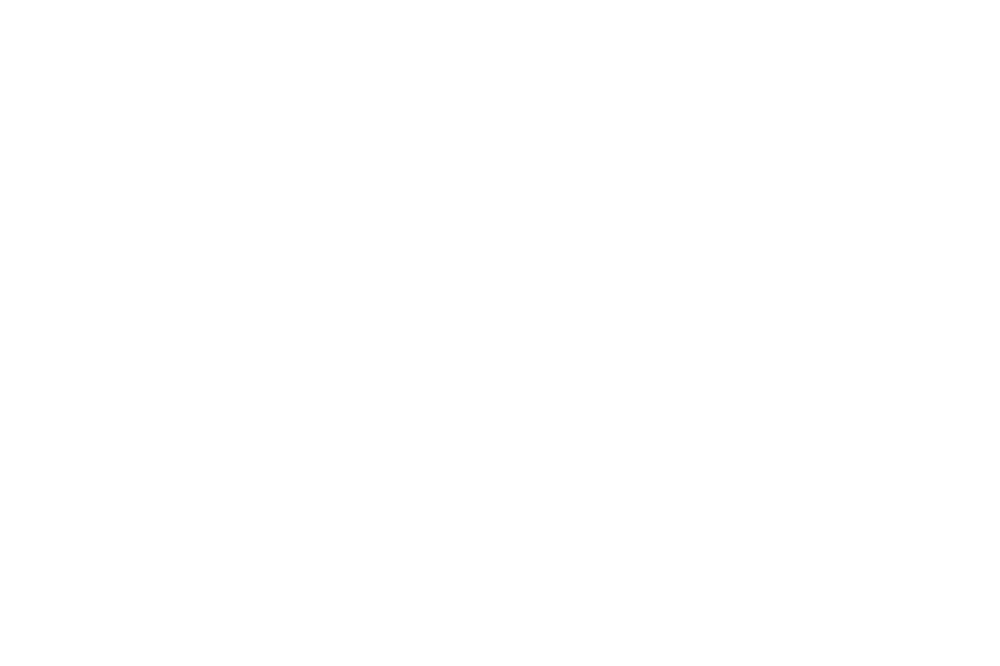

15680 10
PyExiv not present
Experiment: 20200321a-4
Duration: 245.0us (250000 - 5000), for 10 repeats each 2500.0us
Fech = 64.0Msps, total of 15680.0 pts per line, Nacq = 10
200ns at shooting time, probe: BiVi Piezo, target = Film box with water
Timestamp = 2020-03-21 19:34:34.149795


In [9]:
uA = pyUn0.us_json()
uA.JSONprocessing("./data/20200321a-1.json")
uA.create_fft() 
uA.mk2DArray()
print(uA.create_title_text())

uB = pyUn0.us_json()
uB.JSONprocessing("./data/20200321a-3.json")
uB.create_fft() 
uB.mk2DArray()
print(uB.create_title_text())

uC = pyUn0.us_json()
uC.JSONprocessing("./data/20200321a-2.json")
uC.create_fft() 
uC.mk2DArray()
print(uC.create_title_text())

uD = pyUn0.us_json()
uD.JSONprocessing("./data/20200321a-4.json")
uD.create_fft() 
uD.mk2DArray()
print(uD.create_title_text())

4045 41 8192


<IPython.core.display.Javascript object>


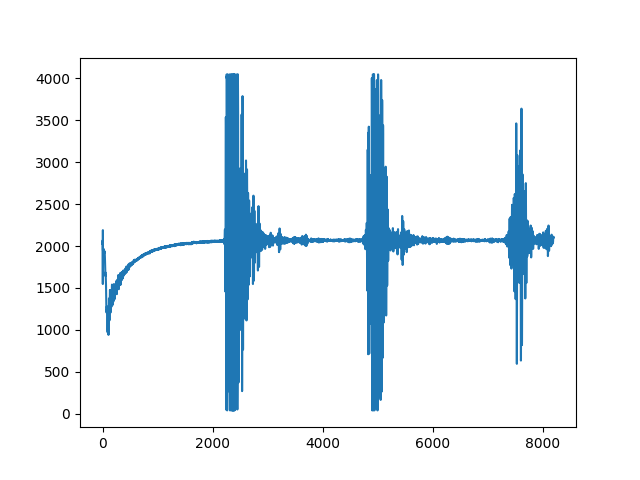

In [11]:
import matplotlib
%matplotlib notebook

import matplotlib.pyplot as plt

signal = uD.tmp
signal = signal / np.max(np.abs(uD.tmp))
signal = signal * 2047 + 2045
signal = signal[0:8192].astype(int)
print(np.max(signal),np.min(signal),len(signal))
plt.plot(signal)
np.savetxt("ref.data", signal, delimiter=";")
plt.show()

## Creating averaged values

In [10]:
uA_averaged = np.sum(uA.raw_2d_image, axis=0)
uB_averaged = np.sum(uB.raw_2d_image, axis=0)
uC_averaged = np.sum(uC.raw_2d_image, axis=0)
uD_averaged = np.sum(uD.raw_2d_image, axis=0)

## Running the graph

In [11]:
fig = go.Figure() 
fig.add_trace(go.Scatter(x=uA.t, y=uA_averaged, name='50ns',mode='lines',opacity = 0.5))
fig.add_trace(go.Scatter(x=uB.t, y=uB_averaged, name = '100ns',mode='lines',opacity = 0.5))
fig.add_trace(go.Scatter(x=uC.t, y=uC_averaged, name='150ns',mode='lines',opacity = 0.5))
fig.add_trace(go.Scatter(x=uD.t, y=uD_averaged, name='200ns',mode='lines',opacity = 0.5))
fig.update_layout(title='Comparing different pulses',
                   xaxis_title='time in us',
                   yaxis_title='V')
fig.show()

In [14]:
plotly.offline.plot(fig, filename = 'comparing_pulse_widths.html', auto_open=False)

'comparing_pulse_widths.html'